In [31]:
import sys

sys.path.append("..")

from utils.utils import (
    load_price_data,
    simulate_pv_generation,
    simulate_load_series,
    count_battery_cycles,
    summarize_simulation,
    calculate_utilization,
    calculate_financial_kpis,
    calculate_profit,
    save_results_to_csv,
    plot_results,
)
from utils.plotting import (
    plot_prices,
    plot_boxplot_by_time_unit,
    plot_charge_discharge_vs_price,
    plot_soc,
    plot_monthly_cycles,
    plot_line_over_time_by_category,
)

import plotly.express as px
import plotly.io as pio
import plotly.graph_objects as go
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

pd.set_option("display.float_format", "{:.2f}".format)

# Force inline renderer
pio.renderers.default = "notebook"

import argparse
from models.threshold_based import ThresholdBasedSimulator
from models.LP_optimization import LPBasedSimulator
from models.rule_based import TimeWindowRuleBasedSimulator
from main import run_simulation

### Load the data

In [2]:
price_data = load_price_data(
    "../data/Day-ahead_prices_202301010000_202501010000_Quarterhour.csv"
)
price_data.head(2)

,Start date,End date,price_eur_per_mwh
timestamp,,,
2024-01-01 00:00:00,2024-01-01 00:00:00,2024-01-01 00:15:00,0.10
2024-01-01 00:15:00,2024-01-01 00:15:00,2024-01-01 00:30:00,0.10


## Strategies based on the analysis

### Define the input variables

In [5]:
sim_config = {
    "capacity_mwh": 1.0,
    "power_mw": 0.5,
    "efficiency": 0.80,
    "degradation_cost_per_mwh": 0.01 * 1000,
    "grid_fee_per_mwh": 0.04 * 1000,
    "pv_setup_cost_eur": 6000.0,
    "capacity_mw": 5,
    "peak_mw": 8,
}

In [6]:
pv_series = simulate_pv_generation(price_data, capacity_mw=sim_config["capacity_mw"])
load_series = simulate_load_series(price_data, peak_mw=sim_config["peak_mw"])

### Threshold Based Simulation (Default: buy=0.05, sell=0.95)

In [7]:
threshold_df, fig = run_simulation(
    model_name="Threshold-Based",
    simulator_cls=ThresholdBasedSimulator,
    price_data=price_data,
    sim_config=sim_config,
    pv_series=None,
    load_series=None,
    buy_threshold=0.05,
    sell_threshold=0.95,
    rerun_simulation=True,
)

Running simulation: Threshold-Based
Saved results to C:\Users\Tayyab\Documents\Github\battery_optimization_strategy\results\Threshold-Based_results.csv
Saved plot to results\Threshold-Based_Operation.html
Threshold-Based Total Profit: €438.47


### Rule Based Simulation (Default: buy between 12 to 14 and sell between 19 to 21)

In [8]:
simple_rule_df, fig = run_simulation(
    model_name="Rule-Based",
    simulator_cls=TimeWindowRuleBasedSimulator,
    price_data=price_data,
    sim_config=sim_config,
    buy_hours=[12, 14],
    sell_hours=[19, 21],
    pv_series=None,
    load_series=None,
    rerun_simulation=True,
)

Running simulation: Rule-Based
Saved results to C:\Users\Tayyab\Documents\Github\battery_optimization_strategy\results\Rule-Based_results.csv
Saved plot to results\Rule-Based_Operation.html
Rule-Based Total Profit: €-11,205.40


### Linear Programming Strategy - Without PV

In [9]:
lp_without_pv_df, fig = run_simulation(
    model_name="Linear-Programming-without-pv",
    simulator_cls=LPBasedSimulator,
    price_data=price_data,
    sim_config=sim_config,
    pv_series=None,
    load_series=None,
    rerun_simulation=True,
)

Running simulation: Linear-Programming-without-pv
Saved results to C:\Users\Tayyab\Documents\Github\battery_optimization_strategy\results\Linear-Programming-without-pv_results.csv
Saved plot to results\Linear-Programming-without-pv_Operation.html
Linear-Programming-without-pv Total Profit: €5,715.20


## Models Comparison

In [10]:
combined_df = pd.concat([simple_rule_df, threshold_df, lp_without_pv_df], axis=0)

### Cumulative Profit Over time

In [11]:
fig = plot_line_over_time_by_category(
    combined_df, value_col="cumulative_profit", model_col="Model_Name"
)
fig.show()

### SoC over time

In [12]:
fig = plot_line_over_time_by_category(
    combined_df, value_col="soc", model_col="Model_Name", title="SoC Over Time"
)
fig.show()

### Grid Costs Over Time

In [13]:
fig = plot_line_over_time_by_category(
    combined_df,
    value_col="cumulative_grid_cost",
    model_col="Model_Name",
    title="Grid Cost Over Time",
)
fig.show()

### Degradation Costs Over Time

In [14]:
fig = plot_line_over_time_by_category(
    combined_df,
    value_col="cumulative_degradation",
    model_col="Model_Name",
    title="Degradation Cost Over Time",
)
fig.show()

## Summary Statistics

In [15]:
summary_df = summarize_simulation(combined_df)
summary_df = summary_df.round(2)
summary_df.to_csv("../results/summary_statistics.csv")
summary_df

,Linear-Programming-without-pv,Rule-Based,Threshold-Based
Total Revenue (€),18481.62,28057.07,16737.20
Total Grid Cost (€),9263.37,32676.23,13098.25
Total Degradation Cost (€),3503.05,6586.25,3200.48
Net Profit (€),5715.20,-11205.40,438.47
Energy Imported (MWh),212.63,365.62,177.75
Energy Exported (MWh),137.68,293.00,142.30
Total Charge (MWh),212.63,365.62,177.75
Total Discharge (MWh),137.68,293.00,142.30
Average SoC (MWh),0.04,0.23,0.26


### Financial KPIs

In [16]:
financial_kpis = calculate_financial_kpis(
    combined_df,
    initial_cost=sim_config["pv_setup_cost_eur"],
    power_mw=sim_config["power_mw"],
)
financial_kpis = financial_kpis.round(2)
financial_kpis.to_csv("../results/financial_kpis.csv")
financial_kpis

,Linear-Programming-without-pv,Rule-Based,Threshold-Based
Total Profit (€),5715.20,-11205.40,438.47
ROI (%),95.25,-186.76,7.31
Estimated Payback Time (Years),1.05,-0.54,13.72
Profit per MWh Cycled (€ / MWh),16.31,-17.01,1.37
Return on Energy (%),99.51,-14.14,27.78
Revenue-to-Cost Ratio,1.45,0.71,1.03
Degradation Cost Share (%),27.44,16.77,19.64
Energy Utilization (%),7.98,15.00,7.29
Average Daily Profit (€),15.62,-30.62,1.20
Profit Volatility (Std Dev),55.65,50.02,32.81


### Linear-Programming Strategy - With PV without Load

In [17]:
lp_with_pv_without_load_df, fig = run_simulation(
    model_name="Linear-Programming-pv-noload",
    simulator_cls=LPBasedSimulator,
    price_data=price_data,
    sim_config=sim_config,
    pv_series=pv_series,
    load_series=None,
    rerun_simulation=True,
)

fig.show()

Running simulation: Linear-Programming-pv-noload
Saved results to C:\Users\Tayyab\Documents\Github\battery_optimization_strategy\results\Linear-Programming-pv-noload_results.csv
Saved plot to results\Linear-Programming-pv-noload_Operation.html
Linear-Programming-pv-noload Total Profit: €86,159.29


In [18]:
plot_line_over_time_by_category(lp_with_pv_without_load_df)

In [19]:
initial_cost = sim_config["power_mw"] * 500 * 1000  # Solar PV cost

In [20]:
summary_df = summarize_simulation(lp_with_pv_without_load_df)
summary_df = summary_df.round(2)
summary_df.to_csv("../results/summary_statistics_only_pv.csv")
summary_df

,Linear-Programming-pv-noload
Total Revenue (€),120952.72
Total Grid Cost (€),859.62
Total Degradation Cost (€),33933.82
Net Profit (€),86159.29
Energy Imported (MWh),5.99
Energy Exported (MWh),1325.22
Total Charge (MWh),2068.16
Total Discharge (MWh),1325.22
Average SoC (MWh),0.23


In [21]:
financial_kpis = calculate_financial_kpis(
    lp_with_pv_without_load_df,
    initial_cost=initial_cost,
    power_mw=sim_config["power_mw"],
)
financial_kpis = financial_kpis.round(2)
financial_kpis.to_csv("../results/financial_kpis_only_pv.csv")
financial_kpis

,Linear-Programming-pv-noload
Total Profit (€),86159.29
ROI (%),34.46
Estimated Payback Time (Years),2.91
Profit per MWh Cycled (€ / MWh),25.39
Return on Energy (%),13970.49
Revenue-to-Cost Ratio,3.48
Degradation Cost Share (%),97.53
Energy Utilization (%),77.26
Average Daily Profit (€),235.41
Profit Volatility (Std Dev),166.05


### Linear-Programming Strategy - With PV with Load

In [22]:
lp_with_pv_with_load_df, fig = run_simulation(
    model_name="Linear-Programming-pv-load",
    simulator_cls=LPBasedSimulator,
    price_data=price_data,
    sim_config=sim_config,
    pv_series=pv_series,
    load_series=load_series,
    rerun_simulation=True,
)

fig.show()

Running simulation: Linear-Programming-pv-load
Saved results to C:\Users\Tayyab\Documents\Github\battery_optimization_strategy\results\Linear-Programming-pv-load_results.csv
Saved plot to results\Linear-Programming-pv-load_Operation.html
Linear-Programming-pv-load Total Profit: €32,930.65


In [23]:
initial_cost = sim_config["power_mw"] * 500 * 1000  # Solar PV cost

In [24]:
summary_df = summarize_simulation(lp_with_pv_with_load_df)
summary_df = summary_df.round(2)
summary_df.to_csv("../results/summary_statistics_pv_with_load.csv")
summary_df

,Linear-Programming-pv-load
Total Revenue (€),47163.11
Total Grid Cost (€),3174.74
Total Degradation Cost (€),11057.72
Net Profit (€),32930.65
Energy Imported (MWh),99.06
Energy Exported (MWh),0.00
Total Charge (MWh),673.28
Total Discharge (MWh),432.50
Average SoC (MWh),0.14


#### Financial KPIs

In [25]:
financial_kpis = calculate_financial_kpis(
    lp_with_pv_with_load_df, initial_cost=initial_cost, power_mw=sim_config["power_mw"]
)
financial_kpis = financial_kpis.round(2)
financial_kpis.to_csv("../results/financial_kpis_pv_load.csv")
financial_kpis

,Linear-Programming-pv-load
Total Profit (€),32930.65
ROI (%),13.17
Estimated Payback Time (Years),7.61
Profit per MWh Cycled (€ / MWh),29.78
Return on Energy (%),1385.57
Revenue-to-Cost Ratio,3.31
Degradation Cost Share (%),77.69
Energy Utilization (%),25.18
Average Daily Profit (€),89.97
Profit Volatility (Std Dev),78.85


#### Grid Electricity Costs Saved

In [26]:
load_series1 = load_series.copy()
load_series1.index = df.index
grid_cost = df.copy()
grid_cost["load_series"] = load_series1
grid_cost["Import_Energy_cost"] = (
    grid_cost["price_eur_per_mwh"] + sim_config["grid_fee_per_mwh"]
) * grid_cost["load_series"]
grid_cost["Import_Energy_cost"].sum()

np.float64(3666193.6816914147)

### Simulation Results / KPIs

In [27]:
plot_charge_discharge_vs_price(lp_with_pv_with_load_df)

In [28]:
plot_soc(lp_with_pv_with_load_df)

In [29]:
utilization = calculate_utilization(lp_with_pv_with_load_df)
utilization

,Value
Full Equivalent Cycles,473.46
Total Discharge (MWh),432.50
Avg Depth of Discharge per Action (MWh),0.03


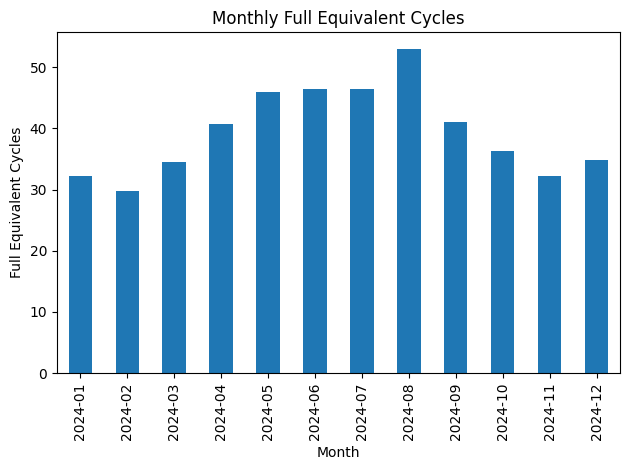

month
2024-01   32.21
2024-02   29.84
2024-03   34.54
2024-04   40.64
2024-05   45.94
2024-06   46.42
2024-07   46.42
2024-08   53.06
2024-09   40.98
2024-10   36.32
2024-11   32.18
2024-12   34.91
Freq: M, Name: discharge_mwh, dtype: float64

In [30]:
plot_monthly_cycles(lp_with_pv_with_load_df)